<a href="https://colab.research.google.com/github/giomagg/DDPS_Maggi_Denart/blob/main/DDPS_Project_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Load Data

In [ ]:
from torch import cuda

cuda.get_device_name(0)

In [ ]:
import os 
import pandas as pd 
from google.colab import drive
drive.mount('/content/drive')
os.chdir("/content/drive/MyDrive/Data Project")
#os.chdir("/content/drive/MyDrive/Colab Notebooks/DDPS/Data Project")

Mounted at /content/drive


In [ ]:
#Load necessary datasets

#MAIN DATASETS
#df2 = pd.read_csv("NordstreamSabotage_class_data.csv")
#df = pd.read_csv("20230312_Nordstream_df.csv")
#df_sabotage = pd.read_csv("20230312_NordstreamSabotage_df.csv")
df = pd.read_csv("Nordstream_class_data.csv")

#COMMUNITY SUBSETS – Obtained after Gephi analysis
df106 = pd.read_csv("Nordstream_com_106.csv")
df246 = pd.read_csv("Nordstream_com_246.csv")
df180 = pd.read_csv("Nordstream_com_180.csv")
df1029 = pd.read_csv("Nordstream_com_1029.csv")
df271 = pd.read_csv("Nordstream_com_271.csv")

## Data Cleaning

In [ ]:
#subset only german and english tweets
df_en = df[df["sourcetweet_lang"] == "en"]
df_de = df[df["sourcetweet_lang"] == "de"]

In [ ]:
df.columns

Index(['author_id', 'tweet_id', 'user_username', 'text', 'in_reply_to_user_id',
       'conversation_id', 'created_at', 'possibly_sensitive', 'lang',
       'user_verified', 'user_created_at', 'user_description',
       'user_profile_image_url', 'user_location', 'user_pinned_tweet_id',
       'user_protected', 'user_name', 'user_url', 'retweet_count',
       'like_count', 'quote_count', 'user_tweet_count', 'user_list_count',
       'user_followers_count', 'user_following_count', 'sourcetweet_type',
       'sourcetweet_id', 'sourcetweet_text', 'sourcetweet_lang',
       'sourcetweet_author_id', 'community_id', 'pageranks'],
      dtype='object')

In [ ]:
df["community_id"].groupby(df['community_id']).value_counts().nlargest(10)

community_id  community_id
180.0         180.0           178486
106.0         106.0            90120
246.0         246.0            29830
1029.0        1029.0           26485
271.0         271.0            24455
479.0         479.0            22914
771.0         771.0            12130
232.0         232.0            10303
998.0         998.0             8294
240.0         240.0             6455
Name: community_id, dtype: int64

In [ ]:
df180 = df[df["community_id"] == 180]
df106 = df[df["community_id"] == 106]
df246 = df[df["community_id"] == 246]
df1029= df[df["community_id"] == 1029]
df271 = df[df["community_id"] == 271]
df479 = df[df["community_id"] == 479]
df771 = df[df["community_id"] == 771]
df232 = df[df["community_id"] == 232]     

In [ ]:
df479 = df[df["community_id"] == 479]
df771 = df[df["community_id"] == 771]
df232 = df[df["community_id"] == 232]  

#**` Network Analysis`**

In [ ]:
! pip install igraph

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import igraph

network = igraph.Graph.TupleList([(row['author_id'], 
                                   row['sourcetweet_author_id']) for index, row in df.iterrows() if row['retweet_count'] > 0 and not pd.isna(row['sourcetweet_author_id'])], directed=True)

igraph.summary(network)
igraph.write(network.simplify(), "nordstream.gml", format="gml")

IGRAPH DN-- 216666 610960 -- 
+ attr: name (v)


# Timeseries

In [ ]:

import altair as alt
import datetime as dt
import pandas as pd
import numpy as np
import math
import json

from twitterexplorer.defaults import *

def plot_timeseries(grouped_tweetdf):
    
    grouped_tweetdf["datetime"] = grouped_tweetdf.index

    # get the right order for color plotting
    types = list(grouped_tweetdf.columns)[:-2]
    counts = []
    for t in types:
        counts.append(grouped_tweetdf[t].sum())
    order_idx = np.array(counts).argsort()[::-1]
    order = [types[i] for i in order_idx]

    # set color range
    domain = order.copy()
    domain.append('total')
    range_ = ['#005AB5','#DC3220','#009E73','#ff7f0e','grey']
    
    # plot 
    C1 = alt.Chart(grouped_tweetdf).mark_area(opacity=0.6).transform_fold(
        fold=order,
        as_=['variable', 'value']
    ).encode(
        alt.X('datetime:T', timeUnit='yearmonthdatehours', title="date"),
        alt.Y('value:Q', stack=None, title="tweet count (hourly)"),
        color=alt.Color("variable:N",
                        legend=alt.Legend(title="tweet type"),
                        scale=alt.Scale(domain=domain, range=range_),
                         )
    )

    # plot total in background    
    C2 = alt.Chart(grouped_tweetdf).mark_area(opacity=0.15).encode(
        alt.X(f'datetime:T', timeUnit='yearmonthdatehours', title='date'),
        alt.Y('total:Q'),
        color=alt.value("black"))

    return (C1+C2).configure_axis(
    labelFontSize=12,
    titleFontSize=12,
).configure_legend(titleFontSize=12,labelFontSize=12)

In [ ]:
from twitterexplorer.plotting import plot_tweetlanguages
from twitterexplorer.plotting import tweetdf_to_timeseries
from twitterexplorer.plotting import plot_timeseries

timeseries = tweetdf_to_timeseries(df, frequency="1D")
plot_timeseries(timeseries).properties(width=800,height=400)



# **`LDA Topic Modelling`**

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"
!pip install textacy

In [ ]:
import textacy
import textacy.tm
from functools import partial

####Com 1029

#####Train

In [ ]:
documents = list(df1029['text'].str.lower())

In [ ]:
corpus = textacy.Corpus("en_core_web_sm", documents)
docs_terms = (textacy.extract.terms(doc,ngs=partial(textacy.extract.ngrams, n=1, include_pos={"NOUN", "ADJ"}),ents=partial(textacy.extract.entities, include_types={ "ORG", "GPE", "LOC"}))for doc in corpus)

tokenized_docs = (textacy.extract.terms_to_strings(doc_terms, by="lemma") for doc_terms in docs_terms)
doc_term_matrix, vocab = textacy.representations.build_doc_term_matrix(tokenized_docs,tf_type="linear", idf_type="smooth")
id_to_term = {id_: term for term, id_ in vocab.items()}

In [ ]:
model = textacy.tm.TopicModel("lda", n_topics=15)
model.fit(doc_term_matrix)
doc_topic_matrix = model.transform(doc_term_matrix)

In [ ]:
for topic_idx, terms in model.top_topic_terms(id_to_term, top_n=10):
    print(f"topic {topic_idx}: {'   '.join(terms)}")

topic 0: stream   seymour   america   russia   pipeline   bombing   nord stream pipeline   htt   way   #germany
topic 1: biden   pipeline   world   nordstream   act   energy   war   destruction   response   crisis
topic 2: europeanunion   president   minded   damage   bad   clear   guy   child   nordst   good
topic 3: ufo   alaska   footage   ufoalaska   ufocanada   amazing   ufomontana   @drunk_opinion   #ufocanada #ufomontana   notuf
topic 4: #germany   nordstream   american   washington   zelensky   russia   interview   politician   scholz   china
topic 5: german   government   o   finding   source   journalist &   terrorist   journalist   attack   true
topic 6: gas   time   greenhouse   nordstream   leak   ton   us &amp   aftermath   delivery   halt
topic 7: hersh   group   ukrainian   country   air   reaction   nordstream   headline   new york times'   nordstr
topic 8: usa   diver   real   thread   cover   navy   summer   mid   ufotwitter   exe
topic 9: terrorism   act   attack   

#####Visualisation

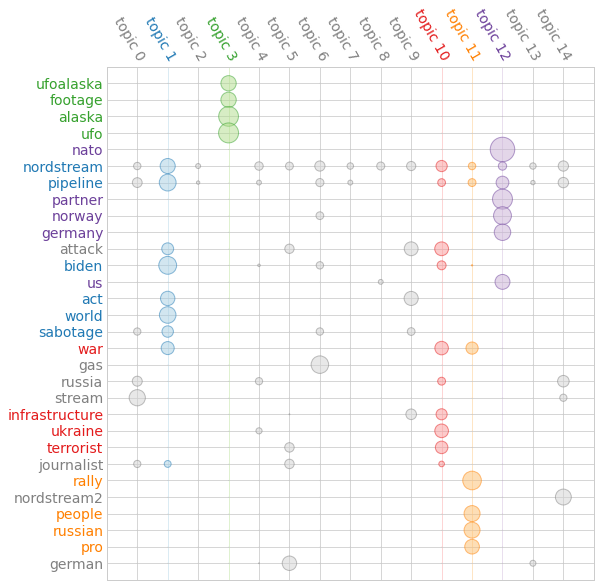

In [ ]:
_ = model.termite_plot(doc_term_matrix, id_to_term, n_terms=30, highlight_topics=[1,3,10,11,12])

####Com 106

#####Train 

In [ ]:
documents = list(df106['text'].str.lower())

In [ ]:
corpus = textacy.Corpus("en_core_web_sm", documents)
docs_terms = (textacy.extract.terms(doc,ngs=partial(textacy.extract.ngrams, n=1, include_pos={"NOUN", "ADJ"}),ents=partial(textacy.extract.entities, include_types={ "ORG", "GPE", "LOC"}))for doc in corpus)

tokenized_docs = (textacy.extract.terms_to_strings(doc_terms, by="lemma") for doc_terms in docs_terms)
doc_term_matrix, vocab = textacy.representations.build_doc_term_matrix(tokenized_docs,tf_type="linear", idf_type="smooth")
id_to_term = {id_: term for term, id_ in vocab.items()}

In [ ]:
model = textacy.tm.TopicModel("lda", n_topics=15)
model.fit(doc_term_matrix)
doc_topic_matrix = model.transform(doc_term_matrix)

In [ ]:
for topic_idx, terms in model.top_topic_terms(id_to_term, top_n=10):
    print(f"topic {topic_idx}: {'   '.join(terms)}")

topic 0: nation   sheep   stream   nord   we   🇩   investigation   german   pipeline   gas
topic 1: medium   president   partner   eu   mainstream   minded   norway   europeanunion   germany   nordstream
topic 2: biden   incident   siberian   clear   unprecedented   past   similar   gas   attack   civilian
topic 3: seymour   security   investigator   suicide   guard   asleep   pipeline   state   group   ukrainian
topic 4: u.s.   cia   year   natural   pipeline   world   people   nordstream   country   western
topic 5: possible   strong   brilliant   journ   hersh   pipeline   nordstream   leak   report   bombing
topic 6: time   methane   greenhouse   tonne   gas   co2   potent   metric   sabotage   nato
topic 7: nordstream2   us   nordstream1   new   lavrov   terror   usa   nordstream   ️   evidence
topic 8: russian   ukraine   europe   russia   war   destruction   nato   dependence   ship   official
topic 9: us   journalist   good   propaganda   empire   way   narrative   courage   me

#####Visualisation

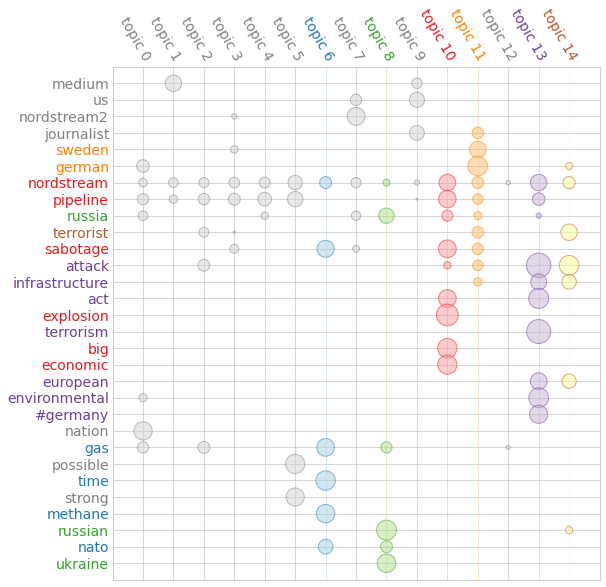

In [ ]:
_ = model.termite_plot(doc_term_matrix, id_to_term, n_terms=30, highlight_topics=[6,8,10,11,13,14])

####Com 180


#####Train

In [ ]:
documents = list(df180['text'].str.lower())

In [ ]:
corpus = textacy.Corpus("en_core_web_sm", documents)
docs_terms = (textacy.extract.terms(doc,ngs=partial(textacy.extract.ngrams, n=1, include_pos={"NOUN", "ADJ"}),ents=partial(textacy.extract.entities, include_types={ "ORG", "GPE", "LOC"}))for doc in corpus)

tokenized_docs = (textacy.extract.terms_to_strings(doc_terms, by="lemma") for doc_terms in docs_terms)
doc_term_matrix, vocab = textacy.representations.build_doc_term_matrix(tokenized_docs,tf_type="linear", idf_type="smooth")
id_to_term = {id_: term for term, id_ in vocab.items()}

In [ ]:
model = textacy.tm.TopicModel("lda", n_topics=15)
model.fit(doc_term_matrix)
doc_topic_matrix = model.transform(doc_term_matrix)

In [ ]:
for topic_idx, terms in model.top_topic_terms(id_to_term, top_n=10):
    print(f"topic {topic_idx}: {'   '.join(terms)}")

topic 0: wie   stream   russland   story   al   pipeline   angegriffen   nordstream   direkt   recherche
topic 1: damit   scholz   verweigert   pipeline   ihre   jede   sprengung   auskunft   tritt   nordstream
topic 2: durch   @mz_storymaker   wäre   seymourhersh   diese   wiederhole   seit   noch   nordstream2   journalismus
topic 3: wir   nordstreamsabotage   dass   ukraine   seine   gemacht   einfach   journalisten   un   ohne
topic 4: und   den   sprengstoff   einer   unter   leute   meter   tonnen   erkenntnisse   @bundeskanzler
topic 5: haben   eine   ist   seymour   hersh   der   nordstream2   hat   nordstream1   deutschland
topic 6: für   + usa kritiklos   attack   niemand   sprengung von #   nato   @michaelesder   @maxotte_say   leck   bundestag
topic 7: nord   schiff   zu   amerikanische   stream   taucher   mittlerweile   wurde   nordstream   die
topic 8: nordstream   german   frau   fragen   pipeline   tagen   source   gaspipeline   baerbock   possible
topic 9: zu   gas   

#####Visaulisation

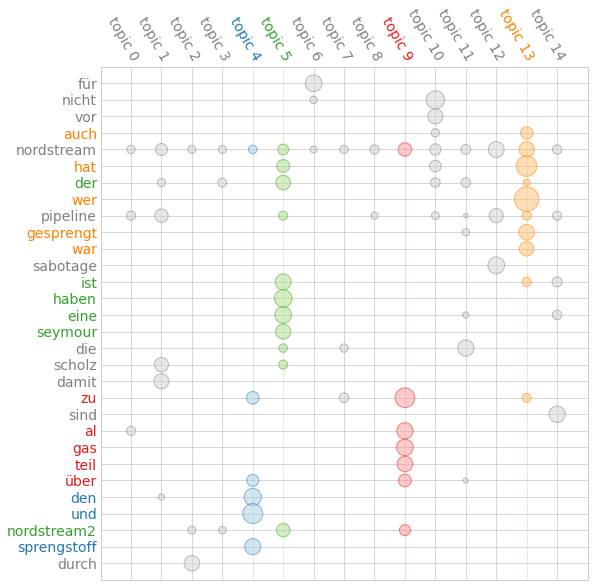

In [ ]:
_ = model.termite_plot(doc_term_matrix, id_to_term, n_terms=30, highlight_topics=[4,5,9,13])

####Com246


#####Train

In [ ]:
documents = list(df246['text'].str.lower())

In [ ]:
corpus = textacy.Corpus("en_core_web_sm", documents)
docs_terms = (textacy.extract.terms(doc,ngs=partial(textacy.extract.ngrams, n=1, include_pos={"NOUN", "ADJ"}),ents=partial(textacy.extract.entities, include_types={ "ORG", "GPE", "LOC"}))for doc in corpus)

tokenized_docs = (textacy.extract.terms_to_strings(doc_terms, by="lemma") for doc_terms in docs_terms)
doc_term_matrix, vocab = textacy.representations.build_doc_term_matrix(tokenized_docs,tf_type="linear", idf_type="smooth")
id_to_term = {id_: term for term, id_ in vocab.items()}

In [ ]:
model = textacy.tm.TopicModel("lda", n_topics=15)
model.fit(doc_term_matrix)
doc_topic_matrix = model.transform(doc_term_matrix)

#####Vizualisation

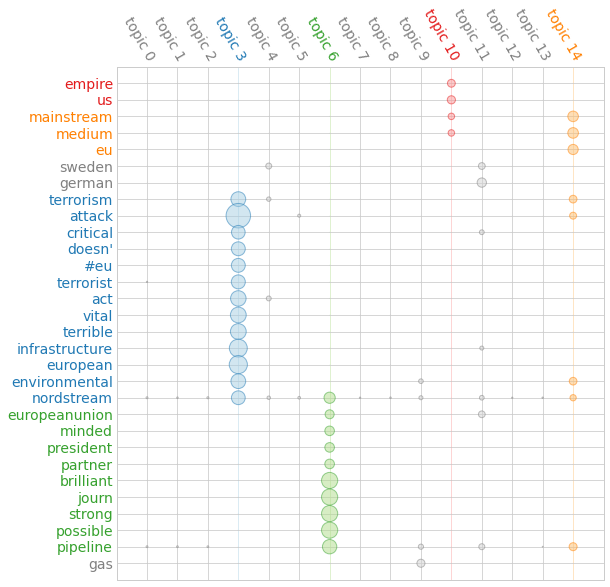

In [ ]:
_ = model.termite_plot(doc_term_matrix, id_to_term, n_terms=30, highlight_topics=[3,6,10,14])

####Com 271

#####Train

In [ ]:
documents = list(df271['text'].str.lower())

In [ ]:
corpus = textacy.Corpus("en_core_web_sm", documents)
docs_terms = (textacy.extract.terms(doc,ngs=partial(textacy.extract.ngrams, n=1, include_pos={"NOUN", "ADJ"}),ents=partial(textacy.extract.entities, include_types={ "ORG", "GPE", "LOC"}))for doc in corpus)

tokenized_docs = (textacy.extract.terms_to_strings(doc_terms, by="lemma") for doc_terms in docs_terms)
doc_term_matrix, vocab = textacy.representations.build_doc_term_matrix(tokenized_docs,tf_type="linear", idf_type="smooth")
id_to_term = {id_: term for term, id_ in vocab.items()}

In [ ]:
model = textacy.tm.TopicModel("lda", n_topics=15)
model.fit(doc_term_matrix)
doc_topic_matrix = model.transform(doc_term_matrix)

In [ ]:
for topic_idx, terms in model.top_topic_terms(id_to_term, top_n=10):
    print(f"topic {topic_idx}: {'   '.join(terms)}")

topic 0: pipe   nordstream2   warning   question   earth   answer   infra   russia   gloom   doom
topic 1: c   incident   sabotage   action   frederiksen   paramount   @statsmin   nordstream   report   norwegian
topic 2: leak   explosion   gas   pipeline   danish   video   nordstream   time   threat   military
topic 3: area   responsible   world   nordstream   state   foreign   danish   claim   russian   leader
topic 4: 🇩   economic   🇷   possible   level   war   hybrid   big   water   pipeline
topic 5: nord   damage   pipeline   solidarity   stream   estonia   bal   nordstream   ukrainian   natural
topic 6: russia   europe   high   price   pipeline   detail   site   gas   thread   @bbckatyaadler &amp
topic 7: today   gas   nordstreamsabotage   leak   oil   satellite   subsea   likely   nordstream   location
topic 8: russian   new   security   service   german   month   western   sweden   navy   gas
topic 9: ukraine   german   swedish   war   contribution   nordstream   picture   under

#####Vizsualisation

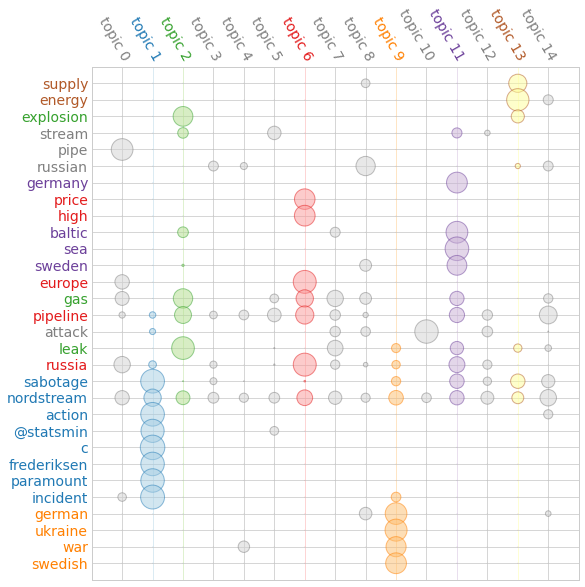

In [ ]:
_ = model.termite_plot(doc_term_matrix, id_to_term, n_terms=30, highlight_topics=[1,2,6,9,11,13])

##Divide different communities – Sabotage Dataset


In [ ]:
#drop rows where community ID and pagerank is NA
df = df.dropna(subset=["community_id", "pageranks"])

In [ ]:
#visualise the top communities
top5_communities = df["community_id"].value_counts().nlargest(5)
top5_communities

151.0    17214
478.0    11507
463.0     5562
246.0     5318
73.0      4774
Name: community_id, dtype: int64

In [ ]:
#create df for top 5 communities
df_com_151 = df[df["community_id"] == 151]
df_com_478 = df[df["community_id"] == 478]
df_com_463 = df[df["community_id"] == 463]
df_com_246 = df[df["community_id"] == 246]
df_com_73 = df[df["community_id"] == 73]

##Official figures' presence in the Dataset


In [ ]:
import os 
import pandas as pd 
from google.colab import drive
drive.mount('/content/drive')
os.chdir("/content/drive/MyDrive/Data Project")
#df = pd.read_csv("20230312_Nordstream_df.csv")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


##### 1. Create the politicians' df with the most prevalent figures in the official debate around Nord Stream

In [ ]:
dic = {"name" : ["Ursula von der Leyen","Joe Biden","Magdalena Anderson","Mateusz Marawiecki",
        "Dmitri Peskov","Nancy Faeser","Mette Frederiksen","Olaf Scholz","Radek Sikorski",
        "Sergei Ladrov","Sergei Ryabkov","Vladimr Putin","Jens Stoltenberg", "Jonas Gahr Støre"],
       "country" : ["EU","US","Sweden","Poland","Russia","Germany","Denmark","Germany","Poland (MEP)","Russia",
           "Russia","Russia","NATO", "Norway"],
       "twitter_handles" : ["vonderleyen","JoeBiden","INokkvi","MorawieckiM","","NancyFaeser","",
                   "OlafScholz","adeksikorski","","","","jensstoltenberg", "jonasgahrstore"]}
df_politicians = pd.DataFrame(dic)

#####2. Check if they are in one of the two datasets

In [ ]:
df_pol_tweets = df[df.user_username.isin(df_politicians["twitter_handles"])]
df_pol_tweets

,tweet_id,user_username,text,in_reply_to_user_id,conversation_id,created_at,possibly_sensitive,author_id,lang,user_verified,...,quote_count,user_tweet_count,user_list_count,user_followers_count,user_following_count,sourcetweet_type,sourcetweet_id,sourcetweet_text,sourcetweet_lang,sourcetweet_author_id
5391,x1574758636869636102,NancyFaeser,RT @BMI_Bund: Das Bundesinnenministerium nimmt...,NaN,x1574758636869636102,2022-09-27T13:51:31.000Z,False,x620221740,de,True,...,0,1867,679,144730,433,retweeted,x1574757428599693313,Das Bundesinnenministerium nimmt die Beschädig...,de,x588242800
27491,x1574856534064041996,vonderleyen,Spoke to @Statsmin Frederiksen on the sabotage...,NaN,x1574856534064041996,2022-09-27T20:20:31.000Z,False,x1146329871418843136,en,True,...,945,4105,6864,1438298,239,NaN,NaN,NaN,NaN,NaN
82441,x1575157073276452867,NancyFaeser,Die mutmaßlichen Sabotageakte an den #NordStre...,NaN,x1575157073276452867,2022-09-28T16:14:45.000Z,False,x620221740,de,True,...,41,1867,679,144729,433,NaN,NaN,NaN,NaN,NaN
207838,x1576868693304561668,vonderleyen,Good talk with @jonasgahrstore on the unaccept...,NaN,x1576868693304561668,2022-10-03T09:36:07.000Z,False,x1146329871418843136,en,True,...,49,4105,6864,1438316,239,NaN,NaN,NaN,NaN,NaN
209758,x1576915388742668289,jonasgahrstore,Pleased to talk to @vonderleyen. Agree that th...,NaN,x1576915388742668289,2022-10-03T12:41:41.000Z,False,x63129578,en,True,...,8,4347,1141,195933,13468,NaN,NaN,NaN,NaN,NaN


In [ ]:
df_pol_tweets_sabotage = df_sabotage[df_sabotage.user_username.isin(df_politicians["twitter_handles"])]
df_pol_tweets_sabotage

,tweet_id,user_username,text,in_reply_to_user_id,conversation_id,...,sourcetweet_type,sourcetweet_id,sourcetweet_text,sourcetweet_lang,sourcetweet_author_id


#####3. Seymour Hersh

In [ ]:
hersch = ["SeymourHersh", "SeymourMHersh"]
df[df.user_username.isin(hersch)]

,tweet_id,user_username,text,in_reply_to_user_id,conversation_id,created_at,possibly_sensitive,author_id,lang,user_verified,...,quote_count,user_tweet_count,user_list_count,user_followers_count,user_following_count,sourcetweet_type,sourcetweet_id,sourcetweet_text,sourcetweet_lang,sourcetweet_author_id


In [ ]:
hersch = ["SeymourHersh", "SeymourMHersh"]
df_sabotage[df_sabotage.user_username.isin(hersch)]

,tweet_id,user_username,text,in_reply_to_user_id,conversation_id,...,sourcetweet_type,sourcetweet_id,sourcetweet_text,sourcetweet_lang,sourcetweet_author_id


#####From this section we can conclude that  **only three of the main politicians** involved in the story have used the #NordStream and that **Seymour Hersh**, one of the people who popularised the narrative that the US was to blame for the attack, is not in the dataset. 

# **`BERTopic`**

###Install BERTopic, load libraries, text setup

In [ ]:
!pip install bertopic

  Created wheel for hdbscan: filename=hdbscan-0.8.29-cp39-cp39-linux_x86_64.whl size=3581989 sha256=600bb086ba0e434e04c23362422ff80a8bf0a5541fd44386b1519ca93031612d
  Stored in directory: /root/.cache/pip/wheels/05/6f/88/1a4c04276b98306f00217a1e300e6ba0252c6aa4f7616067ae
  Created wheel for sentence-transformers: filename=sentence_transformers-2.2.2-py3-none-any.whl size=125942 sha256=23242012e039894c22234974cd4c9d1f1e730cec02197c8955e16a7650e0d7e5
  Stored in directory: /root/.cache/pip/wheels/71/67/06/162a3760c40d74dd40bc855d527008d26341c2b0ecf3e8e11f
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82830 sha256=e667c9a41a689f28d9eca6557215b0c36e20b603a4064d5cbf94ae147227826f
  Stored in directory: /root/.cache/pip/wheels/f4/3e/1c/596d0a463d17475af648688443fa4846fef624d1390339e7e9
  Created wheel for pynndescent: filename=pynndescent-0.5.8-py3-none-any.whl size=55509 sha256=22d9f2ad6a993e4f837a4ffae9c49aec68032e0a1feae5bb3820063c2eefc9e6
  Stored in dir

In [ ]:
import pandas as pd
from bertopic import BERTopic
from sentence_transformers import SentenceTransformer

from umap import UMAP
from hdbscan import HDBSCAN
from sklearn.feature_extraction.text import CountVectorizer

import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
stopwords = stopwords.words('english') + stopwords.words("german")

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
#clean up the text data in the DataFrames by removing URLs, Twitter handles, and non-alphabetic characters, 
#and filter out empty tweets.
import re
import pandas as pd

df1029.text = df1029.apply(lambda row: re.sub(r"http\S+", "", row.text).lower(), 1)
df1029.text = df1029.apply(lambda row: " ".join(filter(lambda x:x[0]!="@", row.text.split())), 1)
df1029.text = df1029.apply(lambda row: " ".join(re.sub("[^a-zA-ZüöäÜÖÄ]+", " ", row.text).split()), 1)
#df1029 = df1029.loc[(df1029.isRetweet == "f") & (df1029.text != ""), :]  
#THIS IS TO ALSO EXCLUDE RETWEETS BUT WE CONSIDER THEM TO ACCOUNT FOR HOW PREVALENT THE TOPIC IS IN THE TWITTER DEBATE
df1029 = df1029.loc[(df1029.text != ""), :]

df106.text = df106.apply(lambda row: re.sub(r"http\S+", "", row.text).lower(), 1)
df106.text = df106.apply(lambda row: " ".join(filter(lambda x:x[0]!="@", row.text.split())), 1)
df106.text = df106.apply(lambda row: " ".join(re.sub("[^a-zA-ZüöäÜÖÄ]+", " ", row.text).split()), 1)
df106 = df106.loc[(df106.text != ""), :]

df180.text = df180.apply(lambda row: re.sub(r"http\S+", "", row.text).lower(), 1)
df180.text = df180.apply(lambda row: " ".join(filter(lambda x:x[0]!="@", row.text.split())), 1)
df180.text = df180.apply(lambda row: " ".join(re.sub("[^a-zA-ZüöäÜÖÄ]+", " ", row.text).split()), 1)
df180 = df180.loc[(df180.text != ""), :]

df246.text = df246.apply(lambda row: re.sub(r"http\S+", "", row.text).lower(), 1)
df246.text = df246.apply(lambda row: " ".join(filter(lambda x:x[0]!="@", row.text.split())), 1)
df246.text = df246.apply(lambda row: " ".join(re.sub("[^a-zA-ZüöäÜÖÄ]+", " ", row.text).split()), 1)
df246 = df246.loc[(df246.text != ""), :]

df271.text = df271.apply(lambda row: re.sub(r"http\S+", "", row.text).lower(), 1)
df271.text = df271.apply(lambda row: " ".join(filter(lambda x:x[0]!="@", row.text.split())), 1)
df271.text = df271.apply(lambda row: " ".join(re.sub("[^a-zA-ZüöäÜÖÄ]+", " ", row.text).split()), 1)
df271 = df271.loc[(df271.text != ""), :]

df479.text = df479.apply(lambda row: re.sub(r"http\S+", "", row.text).lower(), 1)
df479.text = df479.apply(lambda row: " ".join(filter(lambda x:x[0]!="@", row.text.split())), 1)
df479.text = df479.apply(lambda row: " ".join(re.sub("[^a-zA-ZüöäÜÖÄ]+", " ", row.text).split()), 1)
df479 = df479.loc[(df479.text != ""), :]

df771.text = df771.apply(lambda row: re.sub(r"http\S+", "", row.text).lower(), 1)
df771.text = df771.apply(lambda row: " ".join(filter(lambda x:x[0]!="@", row.text.split())), 1)
df771.text = df771.apply(lambda row: " ".join(re.sub("[^a-zA-ZüöäÜÖÄ]+", " ", row.text).split()), 1)
df771 = df771.loc[(df771.text != ""), :]

df232.text = df232.apply(lambda row: re.sub(r"http\S+", "", row.text).lower(), 1)
df232.text = df232.apply(lambda row: " ".join(filter(lambda x:x[0]!="@", row.text.split())), 1)
df232.text = df232.apply(lambda row: " ".join(re.sub("[^a-zA-ZüöäÜÖÄ]+", " ", row.text).split()), 1)
df232 = df232.loc[(df271.text != ""), :]

###Compute and save models on drive – Nordstream Dataset

####Top 5 communities

#####Com 1029

In [ ]:
documents = list(df1029['text'].str.lower())

In [ ]:
model = SentenceTransformer("all-MiniLM-L6-v2")
document_vectors = model.encode(documents, show_progress_bar=True)

Batches:   0%|          | 0/828 [00:00<?, ?it/s]

In [ ]:
vectorizer = CountVectorizer(stop_words=stopwords)
umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = HDBSCAN(min_cluster_size=800, min_samples=2, metric='euclidean', cluster_selection_method='eom')

In [ ]:
topic_model = BERTopic(
    language="multilingual",
    embedding_model=model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer,
    verbose=True
).fit(documents, document_vectors)

2023-03-29 23:19:38,761 - BERTopic - Reduced dimensionality
2023-03-29 23:19:41,838 - BERTopic - Clustered reduced embeddings


In [ ]:
topic_model.save("Nordstream_com_1029_model")

/usr/local/lib/python3.9/dist-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


In [ ]:
print("Total Number of Topics:", len(topic_model.get_topic_freq()))

Total Number of Topics: 8


In [ ]:
freq = topic_model.get_topic_info(); freq.head(20)

,Topic,Count,Name
0,-1,12383,-1_rt_nordstream_pipeline_attack
1,0,7641,0_nordstream_rt_us_russia
2,1,1397,1_criminal_war_fu_bio
3,2,1361,2_die_der_und_von
4,3,1204,3_nordstream_confess_wanna_bragged
5,4,856,4_partner_nato_helps_another
6,5,843,5_alaska_ufo_ufomontana_notuf
7,6,800,6_rally_munich_course_anti


In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.get_representative_docs(2)

['rt amazing footage of the ufo over alaska ufo usa alaska nordstream russiais ufoalaska ufocanada ufomontana notuf',
 'rt amazing footage of the ufo over alaska ufo usa alaska nordstream russiais ufoalaska ufocanada ufomontana notuf',
 'rt amazing footage of the ufo over alaska ufo usa alaska nordstream russiais ufoalaska ufocanada ufomontana notuf']

In [ ]:
topic_model.visualize_barchart(top_n_topics=12, n_words=10)

#####Com 106

In [ ]:
documents = list(df106['text'].str.lower())

In [ ]:
model = SentenceTransformer("all-MiniLM-L6-v2")
document_vectors = model.encode(documents, show_progress_bar=True)

Batches:   0%|          | 0/2817 [00:00<?, ?it/s]

In [ ]:
vectorizer = CountVectorizer(stop_words=stopwords)
umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = HDBSCAN(min_cluster_size=800, min_samples=2, metric='euclidean', cluster_selection_method='eom')

In [ ]:
topic_model = BERTopic(
    language = "multilingual",
    embedding_model=model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer,
    verbose=True
).fit(documents, document_vectors)

2023-03-29 23:36:45,779 - BERTopic - Reduced dimensionality
2023-03-29 23:36:53,167 - BERTopic - Clustered reduced embeddings


In [ ]:
topic_model.save("Nordstream_com_106_model_clussiz_800_multi")	
#topic_model.save("Nordstream_com_106_model_clussiz_20")	
#topic_model.save("Nordstream_com_106_model_clussiz_10")
#topic_model = BERTopic.load("Nordstream_com_106_model_clussiz_30")

/usr/local/lib/python3.9/dist-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


In [ ]:
print("Total Number of Topics:", len(topic_model.get_topic_freq()))

Total Number of Topics: 1579


In [ ]:
freq = topic_model.get_topic_info(); freq.head(20)

,Topic,Count,Name
0,-1,8869,-1_ecommunistforum_suicide_committed_investiga...
1,0,3672,0_acts_biggest_carried_economic
2,1,3334,1_journ_strongest_brilliant_vonderleyen
3,2,3217,2_metric_potent_co2_80
4,3,2995,3_terrible_vital_environmental_european
5,4,1537,4_humiliating_lied_everyone_washington
6,5,1363,5_sheep_nation_ivan_8848_realscottritter
7,6,1270,6_minded_describe_likes_joe
8,7,1257,7_40_exactly_carrying_natural
9,8,1252,8_dgaytandzhieva_similar_sab_past


Error: Runtime no longer has a reference to this dataframe, please re-run this cell and try again.
Error: Runtime no longer has a reference to this dataframe, please re-run this cell and try again.
Error: Runtime no longer has a reference to this dataframe, please re-run this cell and try again.
Error: Runtime no longer has a reference to this dataframe, please re-run this cell and try again.


In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=12)

##### Com 180

In [ ]:
documents = list(df180['text'].str.lower())

In [ ]:
model = SentenceTransformer("all-MiniLM-L6-v2")
document_vectors = model.encode(documents, show_progress_bar=True)

Batches:   0%|          | 0/5578 [00:00<?, ?it/s]

In [ ]:
vectorizer = CountVectorizer(stop_words=stopwords)
umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = HDBSCAN(min_cluster_size=800, min_samples=2, metric='euclidean', cluster_selection_method='eom')

In [ ]:
topic_model = BERTopic(
    language = "multilingual"
    embedding_model=model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer,
    verbose=True
).fit(documents, document_vectors)

2023-03-28 07:54:08,283 - BERTopic - Reduced dimensionality
2023-03-28 07:54:23,342 - BERTopic - Clustered reduced embeddings


In [ ]:
topic_model.save("Nordstream_com_180_model_clussiz_800")	
#topic_model.save("Nordstream_com_180_model_clussiz_20")	
#topic_model.save("Nordstream_com_180_model_clussiz_10")	

In [ ]:
print("Total Number of Topics:", len(topic_model.get_topic_freq()))

Total Number of Topics: 58


In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=12) #TOP 12 of 58 Topics

In [ ]:
topic_model.reduce_topics(documents, nr_topics=10)

2023-03-28 08:07:00,392 - BERTopic - Reduced number of topics from 58 to 10


In [ ]:
topic_model.visualize_barchart(top_n_topics=12)

#####Com 246

In [ ]:
documents = list(df246['text'].str.lower())

In [ ]:
model = SentenceTransformer("all-MiniLM-L6-v2")
document_vectors246 = model.encode(documents, show_progress_bar=True)

Batches:   0%|          | 0/933 [00:00<?, ?it/s]

In [ ]:
vectorizer = CountVectorizer(stop_words=stopwords)
umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = HDBSCAN(min_cluster_size=800, min_samples=2, metric='euclidean', cluster_selection_method='eom')

In [ ]:
topic_model = BERTopic(
    language = "multilingual",
    embedding_model=model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer,
    verbose=True
).fit(documents, document_vectors246)

2023-03-30 05:38:10,953 - BERTopic - Reduced dimensionality
2023-03-30 05:38:17,061 - BERTopic - Clustered reduced embeddings


In [ ]:
topic_model.save("Nordstream_com_246_model_clussiz_800_multi")	


In [ ]:
print("Total Number of Topics:", len(topic_model.get_topic_freq()))

Total Number of Topics: 8


In [ ]:
freq = topic_model.get_topic_info(); freq.head(20)

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=12, n_words = 10)

#####Com 271

In [ ]:
documents = list(df271['text'].str.lower())

In [ ]:
model = SentenceTransformer("all-MiniLM-L6-v2")
document_vectors271 = model.encode(documents, show_progress_bar=True)

Batches:   0%|          | 0/765 [00:00<?, ?it/s]

In [ ]:
vectorizer = CountVectorizer(stop_words=stopwords)
umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = HDBSCAN(min_cluster_size=800, min_samples=2, metric='euclidean', cluster_selection_method='eom')

In [ ]:
topic_model = BERTopic(
    language = "multilingual",
    embedding_model=model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer,
    verbose=True
).fit(documents, document_vectors271)

2023-03-30 05:43:29,252 - BERTopic - Reduced dimensionality
2023-03-30 05:43:32,492 - BERTopic - Clustered reduced embeddings


In [ ]:
topic_model.save("Nordstream_com_271_model_clussiz_800_multi")	

In [ ]:
print("Total Number of Topics:", len(topic_model.get_topic_freq()))

Total Number of Topics: 7


In [ ]:
freq = topic_model.get_topic_info(); freq.head(20)

In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=12)

####Secondary 3 communities

Given that these communities are much smaller, we decided to reduce the min_cluster_size from 800 to 500 in order to have a similar amout of topics. This choice was made after trial and error, trying out different parameters' setups to see which worked best for our case.

#####Com 771

In [ ]:
documents = list(df771['text'].str.lower())

In [ ]:
model = SentenceTransformer("all-MiniLM-L6-v2")
document_vectors = model.encode(documents, show_progress_bar=True)

In [ ]:
vectorizer = CountVectorizer(stop_words=stopwords)
umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = HDBSCAN(min_cluster_size=300, min_samples=2, metric='euclidean', cluster_selection_method='eom')

In [ ]:
topic_model = BERTopic(
    language="multilingual",
    embedding_model=model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer,
    verbose=True
).fit(documents, document_vectors)

In [ ]:
topic_model.save("Nordstream_com_771_model_clussiz_300_multi")	

#####Com 479

In [ ]:
documents = list(df479['text'].str.lower())

In [ ]:
model = SentenceTransformer("all-MiniLM-L6-v2")
document_vectors = model.encode(documents, show_progress_bar=True)

Batches:   0%|          | 0/717 [00:00<?, ?it/s]

In [ ]:
vectorizer = CountVectorizer(stop_words=stopwords)
umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = HDBSCAN(min_cluster_size=500, min_samples=2, metric='euclidean', cluster_selection_method='eom')

In [ ]:
topic_model = BERTopic(
    language = "multilingual",
    embedding_model=model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer,
    verbose=True
).fit(documents, document_vectors)

2023-03-30 07:49:39,409 - BERTopic - Reduced dimensionality
2023-03-30 07:49:42,984 - BERTopic - Clustered reduced embeddings


In [ ]:
topic_model.save("Nordstream_com_479_model_clussiz_500")	

#####Com 232

In [ ]:
documents = list(df232['text'].str.lower())

In [ ]:
model = SentenceTransformer("all-MiniLM-L6-v2")
document_vectors = model.encode(documents, show_progress_bar=True)

Batches:   0%|          | 0/322 [00:00<?, ?it/s]

In [ ]:
vectorizer = CountVectorizer(stop_words=stopwords)
umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model = HDBSCAN(min_cluster_size=300, min_samples=2, metric='euclidean', cluster_selection_method='eom')

In [ ]:
topic_model = BERTopic(
    embedding_model=model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer,
    verbose=True
).fit(documents, document_vectors)

2023-03-29 15:38:39,850 - BERTopic - Reduced dimensionality
2023-03-29 15:38:41,367 - BERTopic - Clustered reduced embeddings


In [ ]:
topic_model.save("Nordstream_com_232_model_clussiz_300")	

###Compute and save models on drive – Sabotage Dataset

####Community 151 – topics


In [ ]:
documents151 = list(df_com_151['text'].str.lower())

In [ ]:
model = SentenceTransformer("all-MiniLM-L6-v2")
document_vectors151 = model.encode(documents151, show_progress_bar=True)

Batches:   0%|          | 0/538 [00:00<?, ?it/s]

In [ ]:
vectorizer = CountVectorizer(stop_words=stopwords)
umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_mode10l = HDBSCAN(min_cluster_size=10, min_samples=2, metric='euclidean', cluster_selection_method='eom')
hdbscan_model20 = HDBSCAN(min_cluster_size=20, min_samples=2, metric='euclidean', cluster_selection_method='eom')
hdbscan_model30 = HDBSCAN(min_cluster_size=30, min_samples=2, metric='euclidean', cluster_selection_method='eom')


In [ ]:
topic_model = BERTopic(
    embedding_model=model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model30,
    vectorizer_model=vectorizer,
    verbose=True
).fit(documents151, document_vectors151)

2023-03-25 12:19:46,081 - BERTopic - Reduced dimensionality
2023-03-25 12:19:51,129 - BERTopic - Clustered reduced embeddings


In [ ]:
print("Total Number of Topics:", len(topic_model.get_topic_freq()))

Total Number of Topics: 153


In [ ]:
#topic_model.save("Sabotage_com_151_model")	
#topic_model = BERTopic.load("Sabotage_com_151_model")

In [ ]:
freq = topic_model.get_topic_info(); freq.head(20)

,Topic,Count,Name
0,-1,2094,-1_nicht_bundeskanzler_co_https
1,0,1302,0_versenk_tbreitschneider_merkt_randnotiz
2,1,953,1_schätzungen_methan_freigesetzt_schäden
3,2,695,2_nerven_dipe_1984_werde_solange
4,3,575,3_nordstream2_europe_responsible_germany
5,4,514,4_vorliegen_untersuchungsergebnisse_spricht_alles
6,5,469,5_entferntesten_bisherigen_hinweis_beatrix_vst...
7,6,461,6_es_ist_ernst_decken_aufgedeckt_dreck
8,7,365,7_deutet_staatsterrorismus_hobb_handelt
9,8,341,8_nachgelegt_vo_eindeutig_kanzler


In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=12)

####Community 246 – topics

In [ ]:
documents = list(df_com_246['text'].str.lower())

In [ ]:
model = SentenceTransformer("all-MiniLM-L6-v2")
document_vectors246 = model.encode(documents, show_progress_bar=True)

Batches:   0%|          | 0/167 [00:00<?, ?it/s]

In [ ]:
vectorizer = CountVectorizer(stop_words=stopwords)
umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
#Try Models with different min_cluster_size
hdbscan_model30 = HDBSCAN(min_cluster_size=30, min_samples=2, metric='euclidean', cluster_selection_method='eom')
hdbscan_model20 = HDBSCAN(min_cluster_size=20, min_samples=2, metric='euclidean', cluster_selection_method='eom')
hdbscan_model10 = HDBSCAN(min_cluster_size=10, min_samples=2, metric='euclidean', cluster_selection_method='eom')


In [ ]:
topic_model = BERTopic(
    embedding_model=model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model30,
    vectorizer_model=vectorizer,
    verbose=True
).fit(documents, document_vectors246)

2023-03-25 12:24:21,722 - BERTopic - Reduced dimensionality
2023-03-25 12:24:28,096 - BERTopic - Clustered reduced embeddings


In [ ]:
print("Total Number of Topics:", len(topic_model.get_topic_freq()))

Total Number of Topics: 66


In [ ]:
topic_docs = topic_model.representative_docs_
list(topic_docs[11])

['rt @jerryhicksunite: #nordstreamsabotage #seymorhersh\nan explosive expose\n\nthe pulitzer prize-winning investigative journalist seymour hers…',
 'rt @jerryhicksunite: #nordstreamsabotage #seymorhersh\nan explosive expose\n\nthe pulitzer prize-winning investigative journalist seymour hers…',
 'rt @jerryhicksunite: #nordstreamsabotage #seymorhersh\nan explosive expose\n\nthe pulitzer prize-winning investigative journalist seymour hers…']

In [ ]:
freq = topic_model.get_topic_info(); freq.head(20)

,Topic,Count,Name
0,-1,797,-1_co_ukraine_putin_story
1,0,385,0_usually_expat_gringo_guys_remember
2,1,295,1_syndicate_gxvevqpc2w_pietjepuk57_government
3,2,186,2_white_nordstreampi_house_denies
4,3,165,3_die_der_es_den
5,4,163,4_waking_slowly_martinrjay_revelations
6,5,157,5_gatqrgcvlq_cnoodles918_thi_resulting
7,6,109,6_pipeline_sabotaged_video_doubts
8,7,109,7_begin_vid_blown_full
9,8,108,8_hurricane_co_keeps_johnhackerla


In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=12)

In [ ]:
#topic_model.save("Sabotage_com_246_model")	

####Community 463 – topics

In [ ]:
documents = list(df_com_463['text'].str.lower())

In [ ]:
model = SentenceTransformer("all-MiniLM-L6-v2")
document_vectors = model.encode(documents, show_progress_bar=True)

Batches:   0%|          | 0/174 [00:00<?, ?it/s]

In [ ]:
vectorizer = CountVectorizer(stop_words=stopwords)
umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model30 = HDBSCAN(min_cluster_size=30, min_samples=2, metric='euclidean', cluster_selection_method='eom')
hdbscan_model20 = HDBSCAN(min_cluster_size=20, min_samples=2, metric='euclidean', cluster_selection_method='eom')
hdbscan_model10 = HDBSCAN(min_cluster_size=10, min_samples=2, metric='euclidean', cluster_selection_method='eom')


In [ ]:
#Run it once for each cluster size
topic_model = BERTopic(
    embedding_model=model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model10,
    vectorizer_model=vectorizer,
    verbose=True
).fit(documents, document_vectors)

2023-03-24 16:17:49,558 - BERTopic - Reduced dimensionality
2023-03-24 16:17:51,891 - BERTopic - Clustered reduced embeddings


In [ ]:
print("Total Number of Topics:", len(topic_model.get_topic_freq()))

Total Number of Topics: 154


In [ ]:
freq = topic_model.get_topic_info(); freq.head(20)

,Topic,Count,Name
0,-1,551,-1_war_us_nordstream_nordstreamsabotage
1,0,880,0_gdek5tokih_arunpudur_talking_rt
2,1,302,1_xlpipeline_ottqfdszkf_kagensnews_deal
3,2,137,2_6nf7thqdfo_anybody_christy39dr_crimes
4,3,125,3_demexit_redwave2022_impeachbiden_nowarwithru...
5,4,121,4_finaltelegraph_j6_kamala_travel
6,5,76,5_putin_russia_invades_ukraine
7,6,76,6_sq1wiy4ix4_initial_georg_heil_nordstreamterr...
8,7,75,7_babbitt_prosecute_modi_jerome
9,8,58,8_investigated_innocent_babu_mani16_found


In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=12)

In [ ]:
#topic_model.save("Sabotage_com_463_model")	

####Community 478 – topics

In [ ]:
documents = list(df_com_478['text'].str.lower())

In [ ]:
model = SentenceTransformer("all-MiniLM-L6-v2")
document_vectors = model.encode(documents, show_progress_bar=True)

Batches:   0%|          | 0/360 [00:00<?, ?it/s]

In [ ]:
vectorizer = CountVectorizer(stop_words=stopwords)
umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model10 = HDBSCAN(min_cluster_size=10, min_samples=2, metric='euclidean', cluster_selection_method='eom')
hdbscan_model20 = HDBSCAN(min_cluster_size=20, min_samples=2, metric='euclidean', cluster_selection_method='eom')
hdbscan_model30 = HDBSCAN(min_cluster_size=30, min_samples=2, metric='euclidean', cluster_selection_method='eom')


In [ ]:
topic_model = BERTopic(
    embedding_model=model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model30,
    vectorizer_model=vectorizer,
    verbose=True
).fit(documents, document_vectors)

2023-03-24 17:02:58,997 - BERTopic - Reduced dimensionality
2023-03-24 17:03:01,752 - BERTopic - Clustered reduced embeddings


In [ ]:
print("Total Number of Topics:", len(topic_model.get_topic_freq()))

Total Number of Topics: 110


In [ ]:
freq = topic_model.get_topic_info(); freq.head(20)

,Topic,Count,Name
0,-1,1832,-1_https_co_wissen_nordstreamsabotage
1,0,765,0_vo_nachgelegt_eindeutig_kanzler
2,1,433,1_beteiligung_neue_beweise_sabotag
3,2,405,2_nordstreamsabot_berliner_zeitung_olafscholz
4,3,353,3_ist_diese_ich_doch
5,4,267,4_versenk_randnotiz_nichtmal_tbreitschneider
6,5,243,5_schätzungen_methan_300_000
7,6,228,6_nerven_dipe_1984_ermittlungsergebnisse_solange
8,7,177,7_frei_geist__beteiligung_neue_beweise
9,8,172,8_kriegsziele_absatzmärkte_gesichert_jahrzehnte


In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=12)

In [ ]:
#topic_model.save("Sabotage_com_478_model")	

####Community 73 – topics

In [ ]:
documents = list(df_com_73['text'].str.lower())

In [ ]:
model = SentenceTransformer("all-MiniLM-L6-v2")
document_vectors73 = model.encode(documents, show_progress_bar=True)

Batches:   0%|          | 0/150 [00:00<?, ?it/s]

In [ ]:
vectorizer = CountVectorizer(stop_words=stopwords)
umap_model = UMAP(n_neighbors=10, n_components=5, min_dist=0.0, metric='cosine', random_state=42)
hdbscan_model30 = HDBSCAN(min_cluster_size=30, min_samples=2, metric='euclidean', cluster_selection_method='eom')
hdbscan_model20 = HDBSCAN(min_cluster_size=20, min_samples=2, metric='euclidean', cluster_selection_method='eom')
hdbscan_model10 = HDBSCAN(min_cluster_size=10, min_samples=2, metric='euclidean', cluster_selection_method='eom')


In [ ]:
topic_model = BERTopic(
    embedding_model=model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model10,
    vectorizer_model=vectorizer,
    verbose=True
).fit(documents, document_vectors73)

2023-03-24 17:15:09,451 - BERTopic - Reduced dimensionality
2023-03-24 17:15:10,729 - BERTopic - Clustered reduced embeddings


In [ ]:
print("Total Number of Topics:", len(topic_model.get_topic_freq()))

Total Number of Topics: 142


In [ ]:
freq = topic_model.get_topic_info(); freq.head(20)

,Topic,Count,Name
0,-1,209,-1_voted_smoke_accurate_happened
1,0,556,0_stephan_scholar_ossenkopp_supports
2,1,225,1_governments_afraid_pub_say
3,2,208,2_die_es_der_und
4,3,187,3_truly_whoever_establish_inquiry
5,4,103,4_58_ordered_according_000
6,5,94,5_telegram_quotes_opposes_inquire
7,6,90,6_pipelines_pipeline_gas_russia
8,7,88,7_finger_elite_silent_stays
9,8,83,8_pandora_opens_inf_crimean


In [ ]:
topic_model.visualize_topics()

In [ ]:
topic_model.visualize_barchart(top_n_topics=12)

In [ ]:
#topic_model.save("Sabotage_com_73_model")	

###Load existing Models for analysis

In [ ]:
#TOP 5 COMMUNITIES
model106 = BERTopic.load("Nordstream_com_106_model_clussiz_800_multi")	
model246 = BERTopic.load("Nordstream_com_246_model_clussiz_800_multi")
model271 = BERTopic.load("Nordstream_com_271_model_clussiz_800_multi")
model1029 = BERTopic.load("Nordstream_com_1029_model")
#model180 = BERTopic.load("Nordstream_com_246_model_clussiz_800")

In [ ]:
#SECONDARY 3 COMMUNITIES
model232 = BERTopic.load("Nordstream_com_232_model_clussiz_300")	
model479 = BERTopic.load("Nordstream_com_479_model_clussiz_500")	
model771 = BERTopic.load("Nordstream_com_771_model_clussiz_300")	


###Interpret and analyse the BERTopic models

In [ ]:
#Assign topics back to their original tweets
df1029["topics"] = model1029.topics_
df106["topics"] = model106.topics_
#df180["topics"] = model1029.topics_
df246["topics"] = model246.topics_
df271["topics"] = model271.topics_

####Timeseries


In [ ]:
timestamps106 = df106.created_at.to_list()
tweets106 = df106.text.to_list()
topics_over_time106 = model106.topics_over_time(tweets106, timestamps106)

49696it [1:00:33, 13.68it/s]

In [ ]:
model106.visualize_topics_over_time(topics_over_time, topics=range(len(model106.get_topic_freq())))

In [ ]:
timestamps246 = df246.created_at.to_list()
tweets246 = df246.text.to_list()
topics_over_time246 = model246.topics_over_time(tweets246, timestamps246)

In [ ]:
model246.visualize_topics_over_time(topics_over_time246, topics=range(len(model246.get_topic_freq())))

In [ ]:
timestamps271 = df271.created_at.to_list()
tweets271 = df271.text.to_list()
topics_over_time271 = model271.topics_over_time(tweets271, timestamps271)

23974it [19:30, 20.48it/s]


In [ ]:
model271.visualize_topics_over_time(topics_over_time271, topics=range(len(model271.get_topic_freq())))

####Terms and Representative docs – Top 5 Communities

#####Com 106

In [ ]:
len(model106.get_topic_freq())

27

In [ ]:
model106.reduce_topics(df106["text"], nr_topics=12)

In [ ]:
model106.visualize_barchart(n_words=10, top_n_topics = 15)

In [ ]:
df106[df106.user_username == "BowesChay"]

,author_id,tweet_id,user_username,text,in_reply_to_user_id,conversation_id,created_at,possibly_sensitive,lang,user_verified,...,user_followers_count,user_following_count,sourcetweet_type,sourcetweet_id,sourcetweet_text,sourcetweet_lang,sourcetweet_author_id,community_id,pageranks,topics
2313,1056957124046143488,1618977399508504576,BowesChay,"Victoria Nuland, darling of NeoCon #Washington...",NaN,x1618977399508504578,2023-01-27 14:21:05,False,en,False,...,28177,5253,NaN,NaN,NaN,NaN,NaN,106,0.003439,0
2314,1056957124046143488,1633153775270522880,BowesChay,The #US now expects us to believe that a “Pro ...,NaN,x1633153775270522901,2023-03-07 17:12:57,False,en,False,...,28175,5253,NaN,NaN,NaN,NaN,NaN,106,0.003439,-1
2315,1056957124046143488,1576568354973704192,BowesChay,Yesterday the #American Secretary of State @Se...,NaN,x1576568354973704195,2022-10-02 13:42:41,False,en,False,...,28178,5253,NaN,NaN,NaN,NaN,NaN,106,0.003439,-1
2316,1056957124046143488,1574723235496747008,BowesChay,It seems the #Nordstream Gas pipeline has been...,NaN,x1574723235496747015,2022-09-27 11:30:50,False,en,False,...,28179,5253,NaN,NaN,NaN,NaN,NaN,106,0.003439,10
2317,1056957124046143488,1629270731023319040,BowesChay,The legendary Seymour Hersh explains why #Bide...,NaN,x1629270731023319045,2023-02-25 00:03:07,False,en,False,...,28176,5253,NaN,NaN,NaN,NaN,NaN,106,0.003439,0
2318,1056957124046143488,1625479032664883200,BowesChay,"Hello @BBCNews⁩, anything on the worlds foremo...",NaN,x1625479032664883203,2023-02-14 12:56:15,False,en,False,...,28176,5253,NaN,NaN,NaN,NaN,NaN,106,0.003439,0
2319,1056957124046143488,1624706283902234624,BowesChay,Who is a terrorist State? \n\nU.S. carried out...,NaN,x1624706283902234626,2023-02-12 09:45:38,False,en,False,...,28176,5253,NaN,NaN,NaN,NaN,NaN,106,0.003439,-1
2320,1056957124046143488,1624922027281768448,BowesChay,"Victoria Nuland, architect of the illegal Coup...",NaN,x1624922027281768448,2023-02-13 00:02:55,False,en,False,...,28176,5253,NaN,NaN,NaN,NaN,NaN,106,0.003439,0
2321,1056957124046143488,1623454648387641344,BowesChay,Seeing as the “Mystery Saboteurs” that blew up...,NaN,x1623454648387641345,2023-02-08 22:52:05,False,en,False,...,28176,5253,NaN,NaN,NaN,NaN,NaN,106,0.003439,10
2322,1056957124046143488,1625479273942339584,BowesChay,RT @BowesChay: The ⁦@WhiteHouse⁩ has refused t...,NaN,x1625479273942339586,2023-02-14 12:57:13,False,en,False,...,28176,5253,retweeted,x1625287698557685760,The ⁦@WhiteHouse⁩ has refused to rule out the ...,en,1.056957e+18,106,0.003439,0


In [ ]:
list(df106.text[df106["topics"] == 10].sample(5))

['Jacques Baud, a former #Swiss intelligence officer points out the countries that gain from the sabotage of the #NordStream\n\n“#Russia does not need to put the Nord Stream gas pipeline out of service, unlike the #US, which has only benefited from it.”\n\n1/3 https://t.co/LNhZQJiePl',
 'RT @I_Katchanovski: "In Nord Stream attack, US officials use proxy media to blame proxy Ukraine. One month after Seymour Hersh reported tha…',
 'RT @BowesChay: The legendary Seymour Hersh explains why #Biden ordered the assault on #NordStream \n\n#Hersh says  #Biden was worried #German…',
 '#FPNews\nSpecialised #UnitedStates divers planted C4 explosives along #Nordstream gas pipelines in 2022 under #JoeBiden supervision, claims journalist\n#Nordstream2 #Nordstream1 \n\nhttps://t.co/w5fttwdt0o',
 'RT @timand2037: Lavrov: by bombing the #NordStream pipelines, #Washington humiliated #Germany, putting Berlin in its place. https://t.co/ba…']

In [ ]:
model106.get_representative_docs()

{-1: ['account has been withheld in portugal finland sweden ireland slovenia czech republic poland slovakia hungary italy malta germany greece romania netherlands bulgaria austria luxembourg latvia united kingdom denmark lithuania croatia estonia cyprus france spain belgium in response to a legal demand learn more',
  'account has been withheld in portugal finland sweden ireland slovenia czech republic poland slovakia hungary italy malta germany greece romania netherlands bulgaria austria luxembourg latvia united kingdom denmark lithuania croatia estonia cyprus france spain belgium in response to a legal demand learn more',
  'account has been withheld in portugal finland sweden ireland slovenia czech republic poland slovakia hungary italy malta germany greece romania netherlands bulgaria austria luxembourg latvia united kingdom denmark lithuania croatia estonia cyprus france spain belgium in response to a legal demand learn more'],
 0: ['who blew up the nordstream gas pipeline zakharo

In [ ]:
freq = model106.get_topic_info(); freq.head(20)

,Topic,Count,Name
0,-1,26473,-1_rt_nordstream_us_german
1,0,23177,0_nordstream_russia_ukraine_rt
2,1,3518,1_potent_metric_greenhouse_tonnes
3,2,3420,2_journ_strongest_brilliant_possible
4,3,2992,3_terrible_vital_attack_environmental
5,4,2478,4_wer_russland_nordstream_bundesregierung
6,5,2240,5_premeditated_critical_still_attack
7,6,2060,6_sourcing_troubling_extremely_anonymous
8,7,1975,7_acts_biggest_carried_economic
9,8,1691,8_humiliating_lied_everyone_washington


#####Com 180

In [ ]:
len(model180.get_topic_freq())

8

In [ ]:
model180.visualize_barchart(n_words=10, top_n_topics = 12)

In [ ]:
model180.get_representative_docs()

{-1: ['rt the nordstream pipeline was a critical german infrastructure that cost billions how can a german chancellor stand besi',
  'rt the nordstream pipeline was a critical german infrastructure that cost billions how can a german chancellor stand besi',
  'rt the nordstream pipeline was a critical german infrastructure that cost billions how can a german chancellor stand besi'],
 0: ['rt when nordstream pipeline was attacked said there would be strongest possible response the brilliant journ',
  'rt when nordstream pipeline was attacked said there would be strongest possible response the brilliant journ',
  'rt when nordstream pipeline was attacked said there would be strongest possible response the brilliant journ'],
 1: ['rt the attack on nordstream was a terrible attack on european vital infrastructure it was an act of environmental terrorism',
  'rt the attack on nordstream was a terrible attack on european vital infrastructure it was an act of environmental terrorism',
  'rt t

In [ ]:
model180.get_topics()

{-1: [('german', 0.23801698906167076),
  ('come', 0.16267409133028465),
  ('mainstream', 0.14770251831242898),
  ('chancellor', 0.14386747559883417),
  ('besi', 0.1438453532110443),
  ('stand', 0.1436410230803461),
  ('cost', 0.14341613972691755),
  ('billions', 0.14336016156294717),
  ('politicians', 0.13068370309342714),
  ('know', 0.10372452367776576)],
 0: [('brilliant', 0.16887627674086056),
  ('strongest', 0.16885653334666198),
  ('journ', 0.16882261115162203),
  ('attacked', 0.16879733854202073),
  ('response', 0.1687874778964424),
  ('possible', 0.16863974462035725),
  ('said', 0.16825717862165615),
  ('would', 0.15386331452290872),
  ('pipeline', 0.14226170444819045),
  ('nordstream', 0.08441654269198084)],
 1: [('vital', 0.1799497569940436),
  ('terrible', 0.17993831991885767),
  ('attack', 0.1793735969521522),
  ('act', 0.1729440114088689),
  ('terrorism', 0.15636115540974363),
  ('environmental', 0.15547872402186716),
  ('european', 0.14049714838163052),
  ('infrastructure'

#####Com 1029

In [ ]:
len(model1029.get_topic_freq())

6

In [ ]:
df1029["topics"] = model1029.topics_

In [ ]:
df1029.loc[df1029['text'].str.contains("Norway US")]

,author_id,tweet_id,user_username,text,in_reply_to_user_id,conversation_id,created_at,possibly_sensitive,lang,user_verified,...,user_followers_count,user_following_count,sourcetweet_type,sourcetweet_id,sourcetweet_text,sourcetweet_lang,sourcetweet_author_id,community_id,pageranks,topics
19816,316130208.0,1.625833e+18,JoeSmithSDK,@AZgeopolitics what happened to #Nordstream wa...,x1312058894416515074,x1625831251851546626,2023-02-15 12:23:05,False,en,False,...,1675,588,NaN,NaN,NaN,NaN,NaN,1029,0.000003,0


In [ ]:
list(df1029[df246["topics"] == 1
            ].text.sample(10))

['RT @LPNH: “This was an act of sabotage, an act of unrivaled vandalism, economically and environmentally. And not a word, no discussion, no…',
 'RT @45LVNancy: #BREAKING - US pipeline gas leak halts deliveries.\n\n🤔 Biden blew up and sabotaged the #Nordstream \n\nWho’s to say our #Climat…',
 'RT @KanekoaTheGreat: THREAD🚨 #Nordstream\n\n"Last June, the Navy divers, operating under the cover of a widely publicized mid-summer NATO exe…',
 "RT @wallacemick: The attack on #Nordstream was a premeditated terrorist attack on critical European infrastructure and the #EU still doesn'…",
 'RT @TenLaughter: Here is the real footage of the #UFO over #Alaska! 🤣\n\n#ufotwitter #USA #Nordstream #RussiaIs #ufoalaska #ufocanada #UFOMon…',
 'RT @nikitheblogger: Wie viele Grüne und Linke haben in den letzten Monaten hier versucht uns zu erzählen, der Russe hätte #Nordstream selbs…',
 'RT @DrDavidBerger: Nordstream2: Liz #Truss hat eine Minute, nachdem die Pipeline in die Luft geflogen ist, eine SMS an US

In [ ]:
model1029.visualize_barchart(top_n_topics=12, n_words=9)

In [ ]:
model1029.get_representative_docs()

{-1: ['rt so one nato partner norway helps another nato partner usa to blow up the pipeline of nato partner germany and that is c',
  'rt so one nato partner norway helps another nato partner usa to blow up the pipeline of nato partner germany and that is c',
  'rt so one nato partner norway helps another nato partner usa to blow up the pipeline of nato partner germany and that is c'],
 0: ['rt biden s doing nordstream',
  'rt biden s doing nordstream',
  'rt biden s doing nordstream'],
 1: ['rt wer ist für die anschläge auf die nordstream pipelines verantwortlich die bundesregierung wei zwar etwas sie kann e',
  'rt wer ist für die anschläge auf die nordstream pipelines verantwortlich die bundesregierung wei zwar etwas sie kann e',
  'rt wer ist für die anschläge auf die nordstream pipelines verantwortlich die bundesregierung wei zwar etwas sie kann e'],
 2: ['rt stop defaming the journalist amp his sources the german government must disclose its findings on the terrorist attacks o',


In [ ]:
df1029.loc[df1029['text'].str.contains("rally in munich today")]

,author_id,tweet_id,user_username,text,in_reply_to_user_id,conversation_id,created_at,possibly_sensitive,lang,user_verified,...,user_list_count,user_followers_count,user_following_count,sourcetweet_type,sourcetweet_id,sourcetweet_text,sourcetweet_lang,sourcetweet_author_id,community_id,pageranks


#####Com 246

In [ ]:
len(model246.get_topic_freq())

11

In [ ]:
df246["topics"] = model246.topics_

In [ ]:
list(df246.text[df246["topics"] == 5 and ].sample(5))

["RT @wallacemick: The attack on #NordStream Pipeline in 2022 was #environmental Terrorism - How come the #EU and Mainstream Media still don'…",
 "RT @wallacemick: The attack on #NordStream Pipeline in 2022 was #environmental Terrorism - How come the #EU and Mainstream Media still don'…",
 "RT @wallacemick: The attack on #NordStream Pipeline in 2022 was #environmental Terrorism - How come the #EU and Mainstream Media still don'…",
 "RT @wallacemick: The attack on #NordStream Pipeline in 2022 was #environmental Terrorism - How come the #EU and Mainstream Media still don'…",
 "RT @wallacemick: The attack on #NordStream Pipeline in 2022 was #environmental Terrorism - How come the #EU and Mainstream Media still don'…"]

1.631372e+18

In [ ]:
df246[df246["topics"] == 1]

,author_id,tweet_id,user_username,text,in_reply_to_user_id,...,sourcetweet_lang,sourcetweet_author_id,community_id,pageranks,topics
46,1.002743e+09,1.606451e+18,rayos_vale,RT @wallacemick: The attack on #NordStream was...,NaN,...,en,248801998.0,246,0.000003,1
48,1.002783e+08,1.604604e+18,ivandnav,RT @wallacemick: The attack on #NordStream was...,NaN,...,en,248801998.0,246,0.000003,1
65,1.004554e+09,1.604266e+18,stephenhawes2,RT @wallacemick: The attack on #NordStream was...,NaN,...,en,248801998.0,246,0.000003,1
72,1.005182e+18,1.604551e+18,KaiserGalactic,RT @wallacemick: The attack on #NordStream was...,NaN,...,en,248801998.0,246,0.000003,1
75,1.005352e+18,1.605326e+18,marley_de_rasta,RT @wallacemick: The attack on #NordStream was...,NaN,...,en,248801998.0,246,0.000003,1
...,...,...,...,...,...,...,...,...,...,...,...
29816,9.989534e+17,1.604473e+18,CSChikere,RT @wallacemick: The attack on #NordStream was...,NaN,...,en,248801998.0,246,0.000003,1
29823,9.994632e+17,1.604284e+18,MaryRei25474400,RT @wallacemick: The attack on #NordStream was...,NaN,...,en,248801998.0,246,0.000003,1
29825,9.995956e+08,1.604199e+18,ciclosonoro,RT @wallacemick: The attack on #NordStream was...,NaN,...,en,248801998.0,246,0.000003,1
29826,9.996156e+17,1.604043e+18,el_Diez79,RT @wallacemick: The attack on #NordStream was...,NaN,...,en,248801998.0,246,0.000003,1


In [ ]:
model246.visualize_barchart(top_n_topics=15, n_words=9)

In [ ]:
model246.get_representative_docs()

{-1: ["rt @wallacemick: if #germany #sweden and most of the #europeanunion don't want to know who blew up #nordstream pipelines, or don't want the…",
  "rt @wallacemick: if #germany #sweden and most of the #europeanunion don't want to know who blew up #nordstream pipelines, or don't want the…",
  "rt @wallacemick: if #germany #sweden and most of the #europeanunion don't want to know who blew up #nordstream pipelines, or don't want the…"],
 0: ['rt @wallacemick: when #nordstream pipeline was attacked @vonderleyen said there would be "strongest possible response".the brilliant  journ…',
  'rt @wallacemick: when #nordstream pipeline was attacked @vonderleyen said there would be "strongest possible response".the brilliant  journ…',
  'rt @wallacemick: when #nordstream pipeline was attacked @vonderleyen said there would be "strongest possible response".the brilliant  journ…'],
 1: ['rt @wallacemick: the attack on #nordstream was a terrible attack on european vital infrastructure, it was an 

#####Com 271

In [ ]:
len(model271.get_topic_freq())

4

In [ ]:
df271["topics"] = model271.topics_

In [ ]:
df271.loc[df271['text'].str.contains("Statsmin")][df271["user_username"] == "vonderleyen"]

,author_id,tweet_id,user_username,text,in_reply_to_user_id,conversation_id,created_at,possibly_sensitive,lang,user_verified,...,user_followers_count,user_following_count,sourcetweet_type,sourcetweet_id,sourcetweet_text,sourcetweet_lang,sourcetweet_author_id,community_id,pageranks,topics
1535,1.146330e+18,1.574857e+18,vonderleyen,Spoke to @Statsmin Frederiksen on the sabotage...,NaN,x1574856534064041996,2022-09-27 20:20:31,False,en,True,...,1438298,239,NaN,NaN,NaN,NaN,NaN,271,0.002829,-1


In [ ]:
list(df271[df271["topics"] == 1].text.sample(15))

['RT @vonderleyen: Spoke to @Statsmin Frederiksen on the sabotage action #Nordstream.\n\nParamount to now investigate the incidents, get full c…',
 'RT @vonderleyen: Spoke to @Statsmin Frederiksen on the sabotage action #Nordstream.\n\nParamount to now investigate the incidents, get full c…',
 'RT @vonderleyen: Spoke to @Statsmin Frederiksen on the sabotage action #Nordstream.\n\nParamount to now investigate the incidents, get full c…',
 'RT @vonderleyen: Spoke to @Statsmin Frederiksen on the sabotage action #Nordstream.\n\nParamount to now investigate the incidents, get full c…',
 'RT @vonderleyen: Spoke to @Statsmin Frederiksen on the sabotage action #Nordstream.\n\nParamount to now investigate the incidents, get full c…',
 'RT @vonderleyen: Spoke to @Statsmin Frederiksen on the sabotage action #Nordstream.\n\nParamount to now investigate the incidents, get full c…',
 'RT @vonderleyen: Spoke to @Statsmin Frederiksen on the sabotage action #Nordstream.\n\nParamount to now investigate 

In [ ]:
model271.visualize_barchart(top_n_topics=12, n_words=9)

In [ ]:
model271.get_representative_docs()

{-1: ['rt @tendar: when russia destroyed the nordstream pipelines it attempted to manipulate gas prices in europe and keep them permanently high.…',
  'rt @tendar: when russia destroyed the nordstream pipelines it attempted to manipulate gas prices in europe and keep them permanently high.…',
  'rt @tendar: when russia destroyed the nordstream pipelines it attempted to manipulate gas prices in europe and keep them permanently high.…'],
 0: ['rt @stassecrieru: reminder #nordstream \n1. january 2006 explosions in southern #russia hit gas pipe &amp; elect tower, halt energy supplies 2 g…',
  'rt @stassecrieru: reminder #nordstream \n1. january 2006 explosions in southern #russia hit gas pipe &amp; elect tower, halt energy supplies 2 g…',
  'rt @stassecrieru: reminder #nordstream \n1. january 2006 explosions in southern #russia hit gas pipe &amp; elect tower, halt energy supplies 2 g…'],
 1: ['rt @vonderleyen: spoke to @statsmin frederiksen on the sabotage action #nordstream.\n\nparamount 

####Terms and Representative docs – Secondary 3 Communities

#####Com 232

In [ ]:
len(model232.get_topic_freq())

3

In [ ]:
model232.visualize_barchart(top_n_topics=12, n_words=10)

In [ ]:
model232.get_representative_docs()

{-1: ['rt the attack on nordstream was a terrible attack on european vital infrastructure it was an act of environmental terrorism',
  'rt the attack on nordstream was a terrible attack on european vital infrastructure it was an act of environmental terrorism',
  'rt the attack on nordstream was a terrible attack on european vital infrastructure it was an act of environmental terrorism'],
 0: ['rt investigators have concluded the nordstream pipeline committed suicide after the guards fell asleep and security came',
  'rt investigators have concluded the nordstream pipeline committed suicide after the guards fell asleep and security came',
  'rt investigators have concluded the nordstream pipeline committed suicide after the guards fell asleep and security came'],
 1: ['rt what do you think happened with the nordstream pipelines a russia sabotaged them b the usa sabotaged them c some',
  'rt what do you think happened with the nordstream pipelines a russia sabotaged them b the usa sabot

#####Com 479

In [ ]:
len(model479.get_topic_freq())

9

In [ ]:
model479.visualize_barchart(top_n_topics=12, n_words=9)

In [ ]:
model479.get_representative_docs()

{-1: ['rt wer auch immer daf r verantwortlich ist es ist ein verbrechen an der menschheit mit den methanemissionen durch die lec',
  'rt wer auch immer daf r verantwortlich ist es ist ein verbrechen an der menschheit mit den methanemissionen durch die lec',
  'rt wer auch immer daf r verantwortlich ist es ist ein verbrechen an der menschheit mit den methanemissionen durch die lec'],
 0: ['rt informiert spekuliert wenn die cia vor wochen vor sabotageakten gegen nordstream amp gewarnt hat dann basierte diese',
  'rt informiert spekuliert wenn die cia vor wochen vor sabotageakten gegen nordstream amp gewarnt hat dann basierte diese',
  'rt informiert spekuliert wenn die cia vor wochen vor sabotageakten gegen nordstream amp gewarnt hat dann basierte diese'],
 1: ['rt gibt es nach der sabotage an den nordstream leitungen ein risiko f r andere pipelines eine besorgniserregenden beobachtu',
  'rt gibt es nach der sabotage an den nordstream leitungen ein risiko f r andere pipelines eine besorg

#####Com 771

In [ ]:
len(model771.get_topic_freq())

5

In [ ]:
model771.visualize_barchart(top_n_topics=12, n_words=10)

In [ ]:
model771.get_representative_docs()

{-1: ['rt investigators have concluded the nordstream pipeline committed suicide after the guards fell asleep and security came',
  'rt investigators have concluded the nordstream pipeline committed suicide after the guards fell asleep and security came',
  'rt investigators have concluded the nordstream pipeline committed suicide after the guards fell asleep and security came'],
 0: ['rt breaking a source speaking on the condition of anonymity told me details of how ordered the nord',
  'rt breaking a source speaking on the condition of anonymity told me details of how ordered the nord',
  'rt breaking a source speaking on the condition of anonymity told me details of how ordered the nord'],
 1: ['rt thread nordstream last june the navy divers operating under the cover of a widely publicized mid summer nato exe',
  'rt thread nordstream last june the navy divers operating under the cover of a widely publicized mid summer nato exe',
  'rt thread nordstream last june the navy divers ope